<a href="https://colab.research.google.com/github/SharovarovAleksandr/Academy/blob/main/Lesson57/Lesson57_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Завдання

#### За допомогою бібліотеки  openCV створити функцію:
 - для зчитування зображення з диску та відображення його на екрані.
 - для збереження зображення на диск
 - для зміни контрасності
 - для зміни яскравості
 - для зміни насиченості кольору
 - для зміни розміру зображення
 - для обізання границь зображення
 - для повороту зображення


In [1]:
import pandas as pd
import numpy as nu
import cv2 as cv2
from google.colab.patches import cv2_imshow


In [2]:
# Функція завантаження зображень
def loading(file):
    img = cv2.imread(file, cv2.IMREAD_COLOR)
    cv2_imshow(img)
    return img


# Функція запису зображення на диск
def writing(img):
    cv2.imwrite('/content/drive/MyDrive/Colab Notebooks/374_copy.jpg', img)
    return 'Writing complete'


# Функція (прімітив) корекції контрасності та яркості зобрачення 
def contrast_brightness(img):
    x=float(input('Введіть коефіціент корекції контрастності зображення [0:3]: '))
    y=float(input('Введіть коефіціент корекції яркості зображення [-200:200]: '))
    return img*x+y


# Функція автоматичного контрастування
def auto_contrast(img):
    clahe = cv2.createCLAHE(clipLimit=3., tileGridSize=(8,8))
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)  
    l, a, b = cv2.split(lab)  
    l2 = clahe.apply(l)  
    lab = cv2.merge((l2,a,b)) 
    return cv2.cvtColor(lab, cv2.COLOR_LAB2BGR) 

     
# Функція зміни кольорової насиченості зображення
def saturation(img):
    x=float(input('Введіть коефіціент зміни кольорової насиченості зображення [0:5] : '))
    hsv_img = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    hsv_img[:, :, 1] = hsv_img[:, :, 1] * x
    return cv2.cvtColor(hsv_img, cv2.COLOR_HSV2BGR)


#  Функція обрізання фотографії
def cropped(img):
    size=img.shape
    print('Розмір зображення ', size[0],'x',size[1])
    x1=int(input('Введіть координату х1 : '))
    y1=int(input('Введіть координату y1 : '))
    x2=int(input('Введіть координату х2 : '))
    y2=int(input('Введіть координату y2 : '))
    return img[x1:x2,y1:y2]


# Функція зміни розміру фотографії
def resize(img):
    size=img.shape
    print('Розмір оригінального зображення ', size[0],'x',size[1])
    x=float(input('Введіть коефіціент перетворення розміру зображення : '))
    width = int(size[1] * x)
    height = int(size[0] * x)
    print('Розмір зображення після перетворення ',width,'x',height)
    dim = (width, height)
    return cv2.resize(img, dim, interpolation = cv2.INTER_AREA)

# Функція повороту зображення
def rotation(img):
    angl=int(input('Введіть кут повороту зображення у градусах : '))
    size = img.shape
    center = (size[1] // 2, size[0] // 2)
    new_img=cv2.getRotationMatrix2D(center, angl, 1.0)
    rotated = cv2.warpAffine(img, new_img, (size[1], size[0]))
    return rotated
    


### Завантаження зображення

Введіть коефіціент перетворення розміру зображення : 0.2


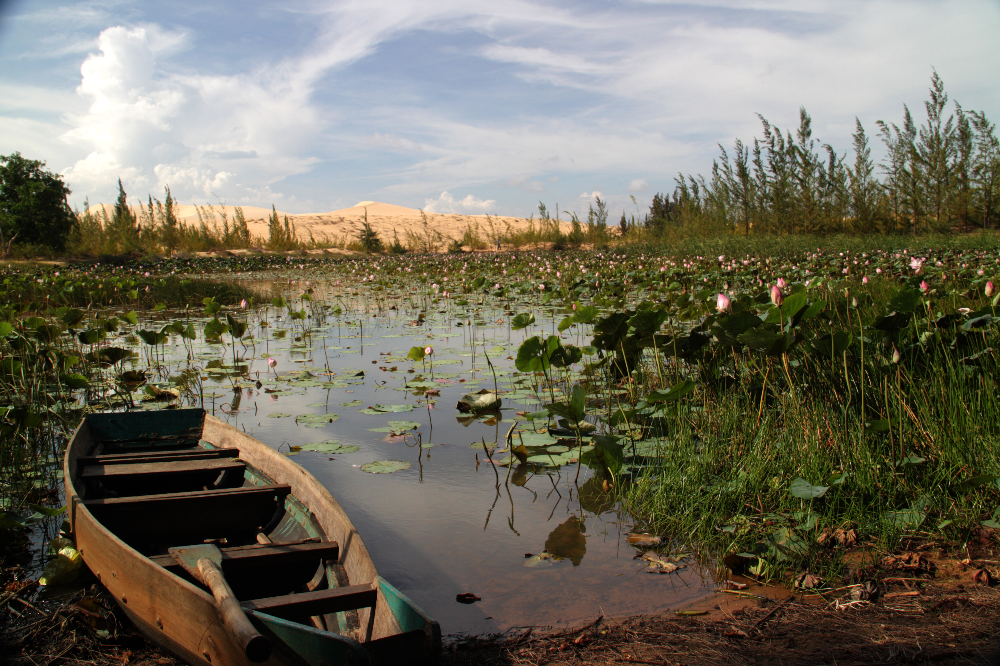

Розмір оригінального зображення  2848 x 4272
Розмір зображення після перетворення  854 x 569


In [5]:
file='/content/drive/MyDrive/Colab Notebooks/374.jpg'
img=loading(file)
img=resize(img)

### Запис зображення на диск

In [4]:
writing(img)

'Writing complete'

In [6]:
img.shape


(569, 854, 3)

### Обрізання границь зображення

Розмір зображення  569 x 854
Введіть координату х1 : 450
Введіть координату y1 : 450
Введіть координату х2 : 568
Введіть координату y2 : 850


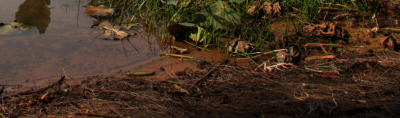

In [7]:
cv2_imshow(cropped(img))

### Зміна розміру зображення

Розмір оригінального зображення  569 x 854
Введіть коефіціент перетворення розміру зображення : 0.9
Розмір зображення після перетворення  768 x 512


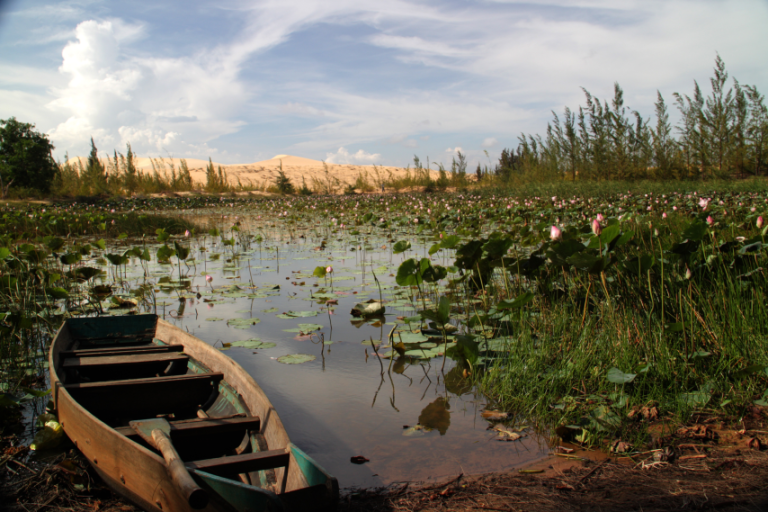

In [8]:
cv2_imshow(resize(img))

### Поворот зображення на визначений кут

Введіть кут повороту зображення у градусах : 30


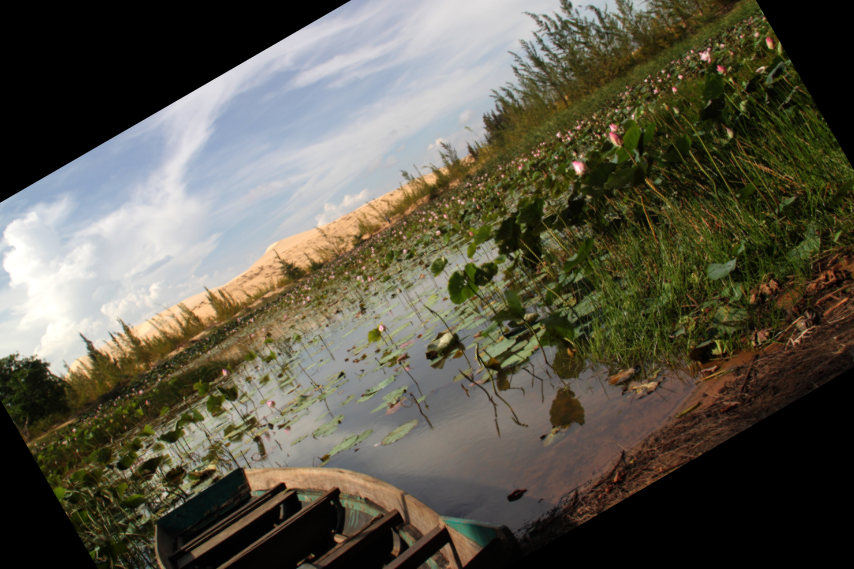

In [10]:
cv2_imshow(rotation(img))

### Зміна контрасності та яркості зображення

Введіть коефіціент корекції контрастності зображення [0:3]: 1
Введіть коефіціент корекції яркості зображення [-200:200]: -50


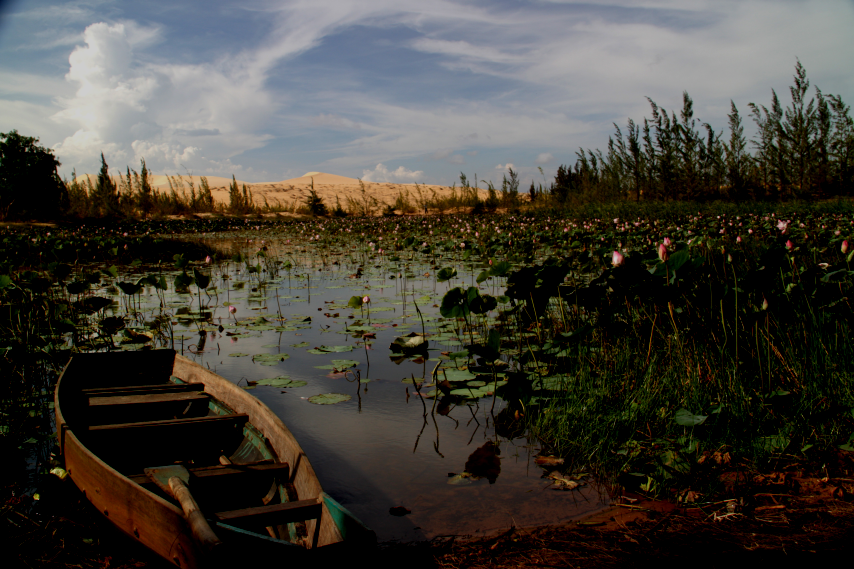

In [11]:
cv2_imshow(contrast_brightness(img))

### Автоматична зміна контрасності зображення

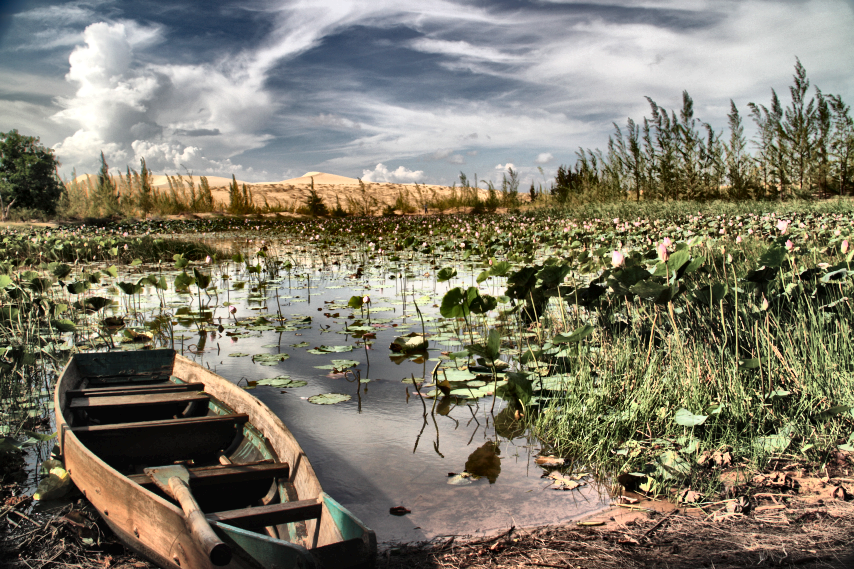

In [12]:
cv2_imshow(auto_contrast(img))

### Зміна насиченості кольору зображення

Введіть коефіціент зміни кольорової насиченості зображення [0:5] : 1.5


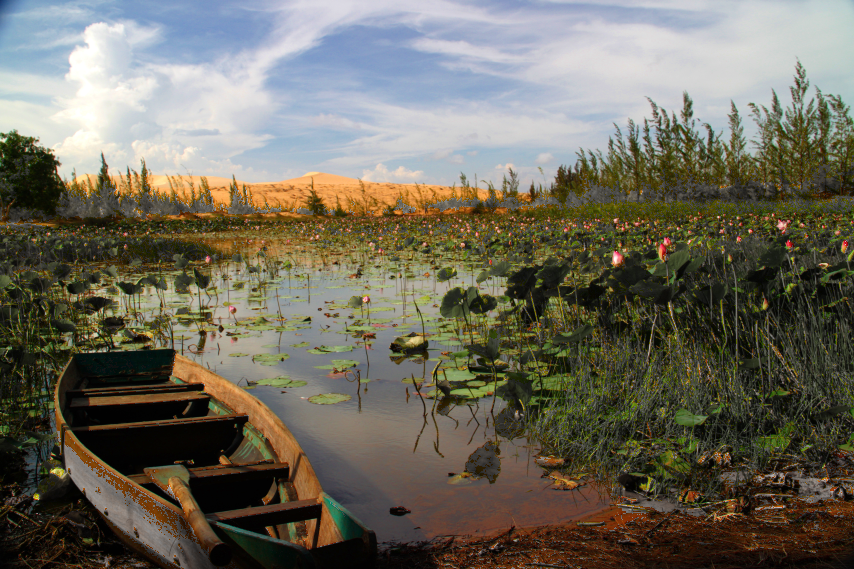

In [13]:
cv2_imshow(saturation(img))

Введіть коефіціент зміни кольорової насиченості зображення [0:5] : 0


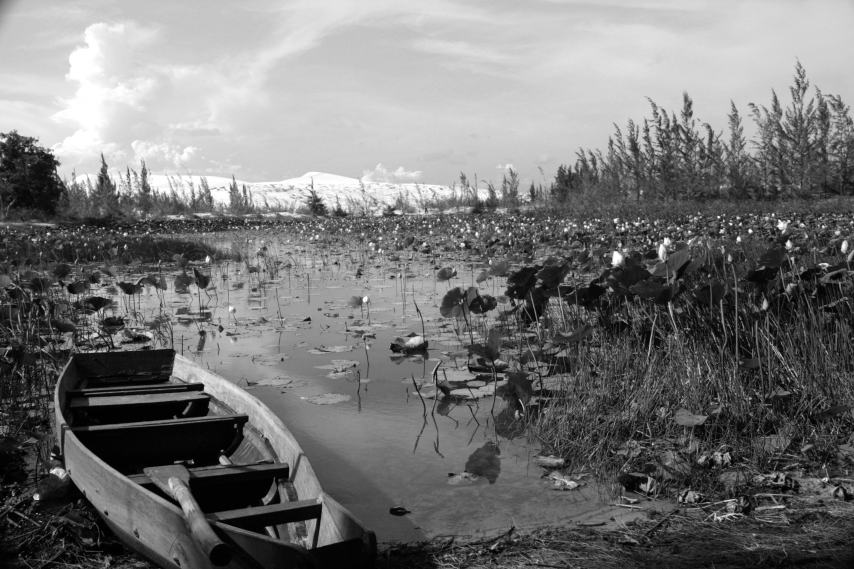

In [14]:
cv2_imshow(saturation(img))
